**Objective:**
Create a generative model to produce new content, such as text generation, image synthesis, or data augmentation.


####Image Generation using GANs.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!cp '/content/drive/MyDrive/my project/kaggle.json' '/content'   #renew json file

In [4]:
import zipfile
import os

os.environ['KAGGLE_CONFIG_DIR'] = "/content"

Downloading dataset from kaggle

In [5]:
!kaggle datasets download -d deewakarchakraborty/portrait-paintings

 99% 222M/223M [00:13<00:00, 15.8MB/s]
100% 223M/223M [00:13<00:00, 17.1MB/s]


In [6]:
zip_ref = zipfile.ZipFile('portrait-paintings.zip', 'r') #Opens the zip file in read mode
zip_ref.extractall('/content') #Extracts the files into the /content folder
zip_ref.close()


Deep Convolutional GAN (DCGAN)

We'll be using DCGAN for this task.

In [8]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt



def show_tensor_images(image_tensor, num_images=20, size=(1, 128, 128)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

**Generator**
The first component we'll make is the generator. We'll be using 5 layers in this.

In [9]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector
        channels: the number of channels in the images
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=256, channels=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 16),
            self.make_gen_block(hidden_dim * 16, hidden_dim * 8, kernel_size=2, stride=2),
            self.make_gen_block(hidden_dim * 8, hidden_dim * 8, kernel_size=2, stride=2),
            self.make_gen_block(hidden_dim * 8, hidden_dim * 4, kernel_size=2, stride=2),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 4, kernel_size=2, stride=2),
            self.make_gen_block(hidden_dim * 4, channels, kernel_size=2, stride=2, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=4, stride=1, final_layer=False,padding = 'same'):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN,
        corresponding to a transposed convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise
                      (affects activation and batchnorm)
        '''

        # Build the neural block
        if not final_layer:
            return nn.Sequential(  #we'll get 3 nn layers out of this
                torch.nn.ConvTranspose2d(input_channels, output_channels, kernel_size,stride),#ConvTranspose2d is used for upsampling or transposed convolution. It inflates the input tensor's spatial dimensions by applying a learnable upsampling operation.
                torch.nn.BatchNorm2d(output_channels),
                torch.nn.ReLU()
            )
        else: # Final Layer
            return nn.Sequential(
                torch.nn.ConvTranspose2d(input_channels, output_channels, kernel_size,stride),
                torch.nn.Tanh()
            )

    def unsqueeze_noise(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns a copy of that noise with width and height = 1 and channels = z_dim.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        return noise.view(len(noise), self.z_dim, 1, 1)

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = self.unsqueeze_noise(noise)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

In [10]:
from torchsummary import summary
z_dim = 256     #noise vector that we take
device = "cuda" if torch.cuda.is_available() else "cpu"
device

# Instantiate Generator model
model = Generator()

# Move the model to the appropriate device (GPU/CPU)
model.to(device)

# Define the input shape (noise vector)
input_shape = (1, z_dim)  # Assuming z_dim is the dimension of the noise vector

# Generate a random noise sample to determine the input size for the summary
sample_noise = torch.randn(1, z_dim).to(device)

# Get the summary of the model
summary(model, input_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1           [-1, 1024, 4, 4]       4,195,328
       BatchNorm2d-2           [-1, 1024, 4, 4]           2,048
              ReLU-3           [-1, 1024, 4, 4]               0
   ConvTranspose2d-4            [-1, 512, 8, 8]       2,097,664
       BatchNorm2d-5            [-1, 512, 8, 8]           1,024
              ReLU-6            [-1, 512, 8, 8]               0
   ConvTranspose2d-7          [-1, 512, 16, 16]       1,049,088
       BatchNorm2d-8          [-1, 512, 16, 16]           1,024
              ReLU-9          [-1, 512, 16, 16]               0
  ConvTranspose2d-10          [-1, 256, 32, 32]         524,544
      BatchNorm2d-11          [-1, 256, 32, 32]             512
             ReLU-12          [-1, 256, 32, 32]               0
  ConvTranspose2d-13          [-1, 256, 64, 64]         262,400
      BatchNorm2d-14          [-1, 256,

**Discriminator**

The second component we need to create is the discriminator.

We will use 3 layers in our discriminator's neural network. Like with the generator, we'll need create the function to create a single neural network block for the discriminator.

In [11]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        channels: the number of channels in the images
        hidden_dim: the inner dimension
    '''
    def __init__(self, channels=3, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(channels, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2,kernel_size =2 , stride = 2),
            self.make_disc_block(hidden_dim*2, hidden_dim *4),
            self.make_disc_block(hidden_dim*4, hidden_dim *8),
            self.make_disc_block(hidden_dim*8, hidden_dim *16),
            self.make_disc_block(hidden_dim * 16, 1, final_layer=True),
        )
    def make_disc_block(self, input_channels, output_channels, kernel_size=2, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of DCGAN,
        corresponding to a convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise
                      (affects activation and batchnorm)
        '''

        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                torch.nn.Conv2d(input_channels, output_channels, kernel_size,stride),
                torch.nn.BatchNorm2d(output_channels),
                torch.nn.LeakyReLU(.2)
            )
        else: # Final Layer
            return nn.Sequential(
                torch.nn.Conv2d(input_channels, output_channels, kernel_size=4,stride=1),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor,
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_dim)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)


# Instantiate your Discriminator model
discriminator_model = Discriminator()

# Move the model to the appropriate device (GPU/CPU)
discriminator_model.to(device)

# Assuming input shape for our discriminator
input_shape = (3, 128, 128)  #  RGB images of size 64x64

# Get the summary of the model
summary(discriminator_model, input_shape)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]             832
       BatchNorm2d-2           [-1, 64, 64, 64]             128
         LeakyReLU-3           [-1, 64, 64, 64]               0
            Conv2d-4          [-1, 128, 32, 32]          32,896
       BatchNorm2d-5          [-1, 128, 32, 32]             256
         LeakyReLU-6          [-1, 128, 32, 32]               0
            Conv2d-7          [-1, 256, 16, 16]         131,328
       BatchNorm2d-8          [-1, 256, 16, 16]             512
         LeakyReLU-9          [-1, 256, 16, 16]               0
           Conv2d-10            [-1, 512, 8, 8]         524,800
      BatchNorm2d-11            [-1, 512, 8, 8]           1,024
        LeakyReLU-12            [-1, 512, 8, 8]               0
           Conv2d-13           [-1, 1024, 4, 4]       2,098,176
      BatchNorm2d-14           [-1, 102

**Tranining Step**

In [12]:
from PIL import Image
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader

In [19]:
criterion = nn.BCEWithLogitsLoss()  #loss function

display_step = 225        #how often we display our output
batch_size = 128          #number of images per forward/backward pass
lr = 0.0002               #learning rate

# These parameters control the optimizer's momentum:
beta_1 = 0.5
beta_2 = 0.999

#transformation of input images
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),  # Convert image to tensor
    transforms.Normalize((0.5,), (0.5,))  #dataset is then normalized to a range [-1,1]
])



Getting our data and creating dataloader:

In [20]:
class Dataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_list = os.listdir(root_dir)  # Get list of image filenames

    def __len__(self):
        return len(self.image_list)

    def __getitem__(self, idx):
        img_name = os.path.join(self.root_dir, self.image_list[idx])
        image = Image.open(img_name).convert('RGB')  # Open image in RGB mode

        if self.transform:
            image = self.transform(image)

        label = 1  # Replace this with label extraction logic

        return image, label

# Directory containing your input data images
dataset_path = '/content/Images'

# Initialize the custom dataset
dataset = Dataset(root_dir=dataset_path, transform=transform)

# Create DataLoader

dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [21]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr, betas=(beta_1, beta_2))

# we can initialize the weights to the normal distribution
# with mean 0 and standard deviation 0.02....usually done with gans
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Finally, we can train our GAN! For each epoch, we will process the entire dataset in batches. For every batch, we will update the discriminator and generator. Then, we can see DCGAN's results!

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 5, step 225: Generator loss: 2.0094140046172666, discriminator loss: 0.2703747206677994


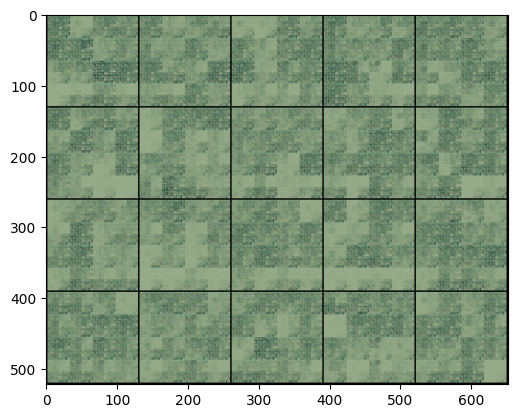

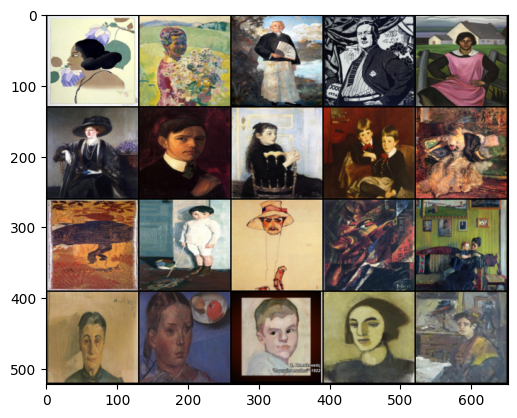

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 10, step 450: Generator loss: 1.4688979117075607, discriminator loss: 0.5238593216737111


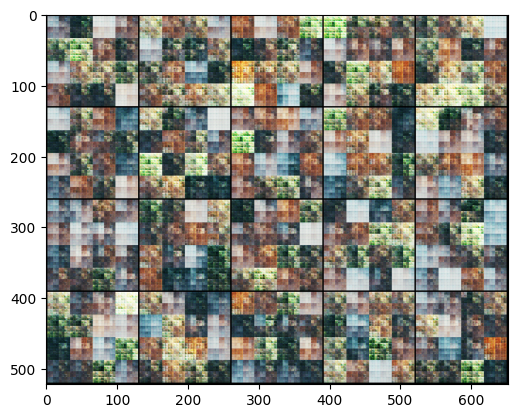

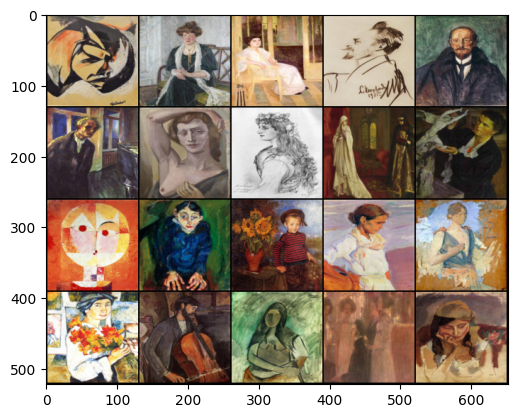

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 15, step 675: Generator loss: 1.7382338733143283, discriminator loss: 0.486288616259893


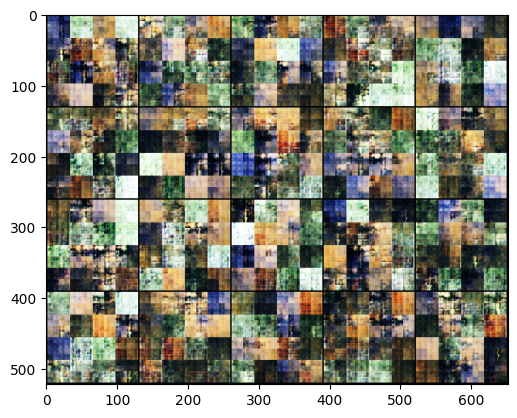

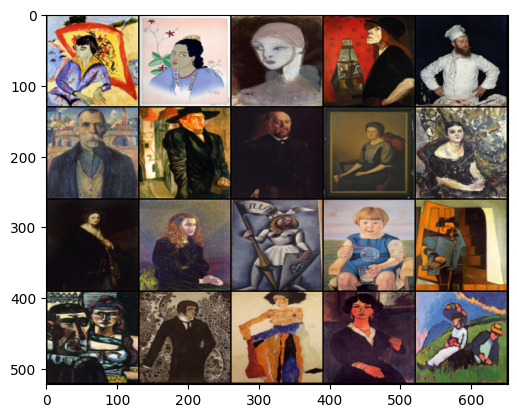

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 20, step 900: Generator loss: 1.5980096136199113, discriminator loss: 0.512195524904463


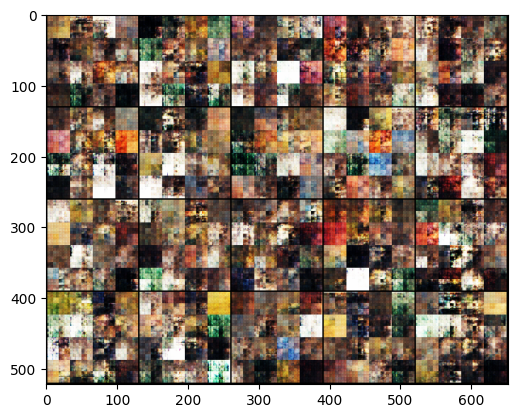

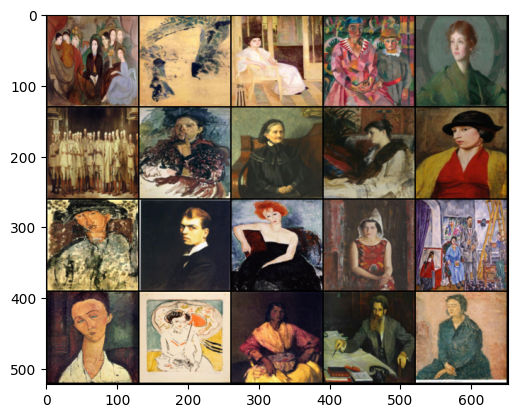

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 25, step 1125: Generator loss: 1.5200774312019345, discriminator loss: 0.505855843491025


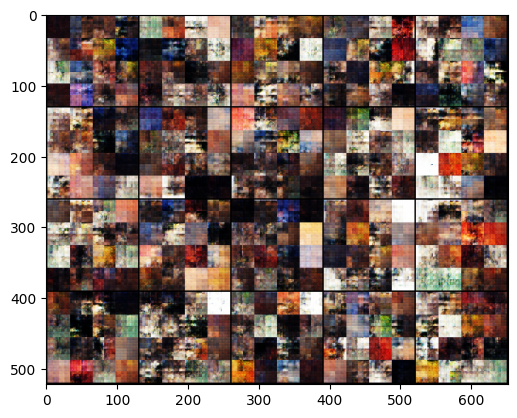

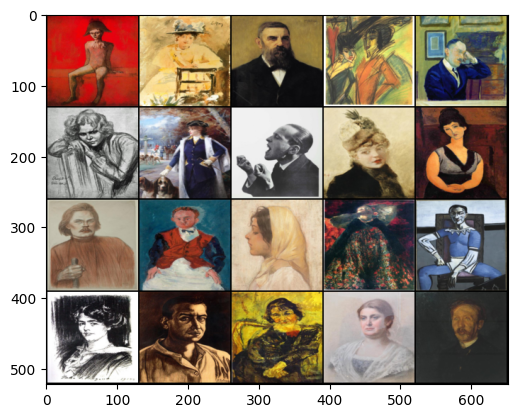

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 30, step 1350: Generator loss: 1.4661520700984534, discriminator loss: 0.5027356668313344


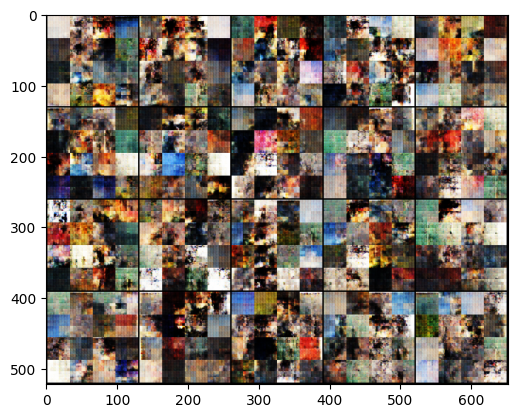

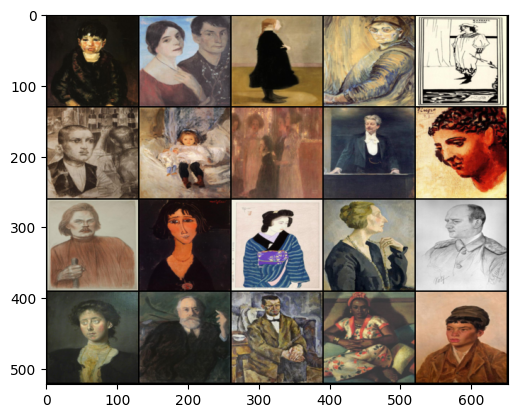

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 35, step 1575: Generator loss: 1.478714079062143, discriminator loss: 0.48942465888129366


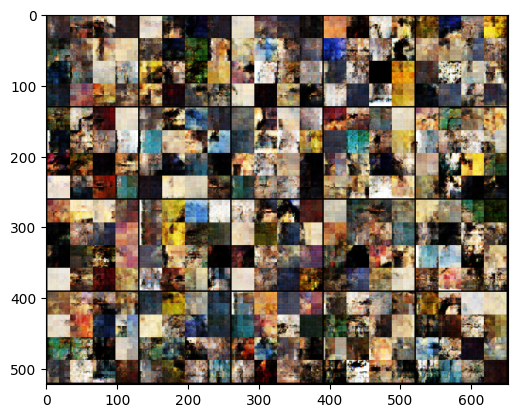

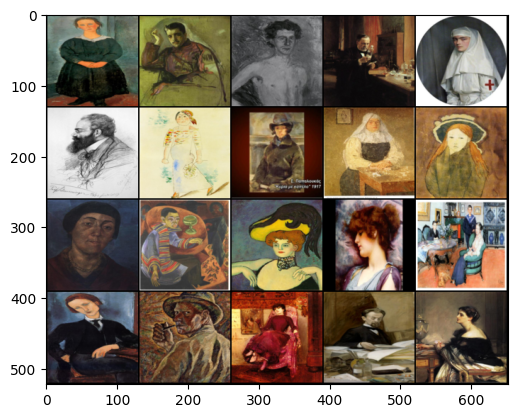

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 40, step 1800: Generator loss: 1.5296587459246325, discriminator loss: 0.4618685159418318


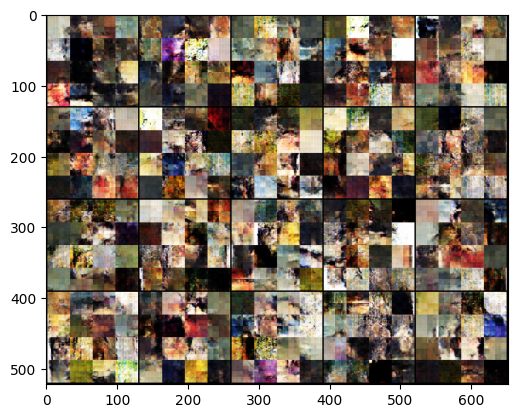

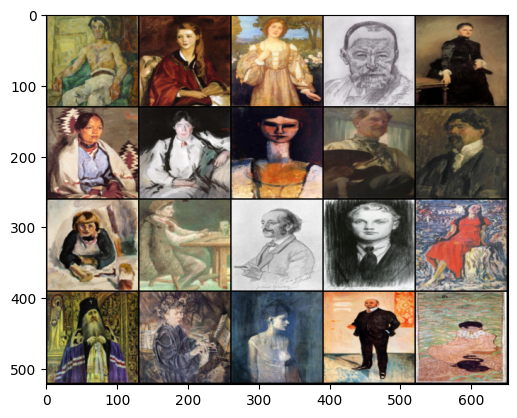

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 45, step 2025: Generator loss: 1.6363922693994306, discriminator loss: 0.43530128479003904


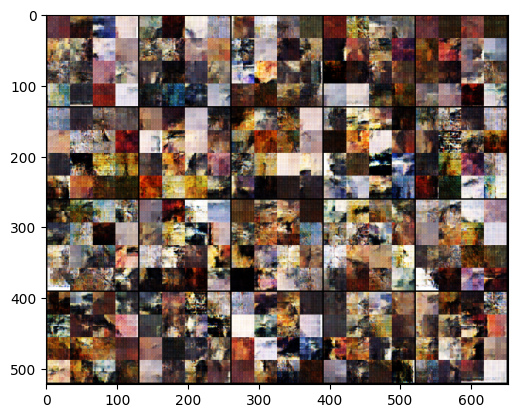

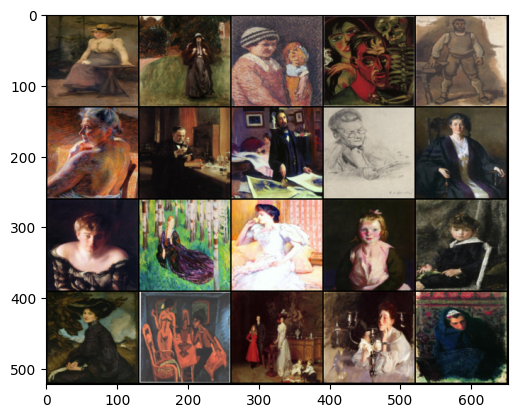

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 50, step 2250: Generator loss: 1.6551630605591672, discriminator loss: 0.43060084554884165


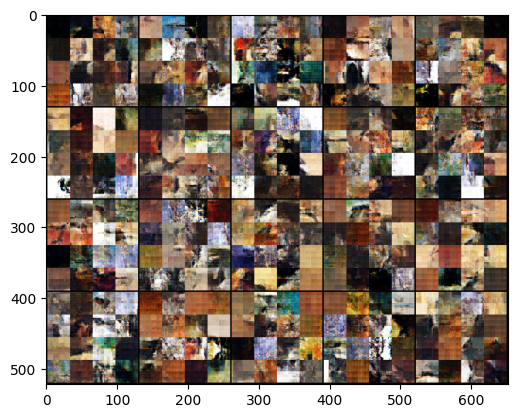

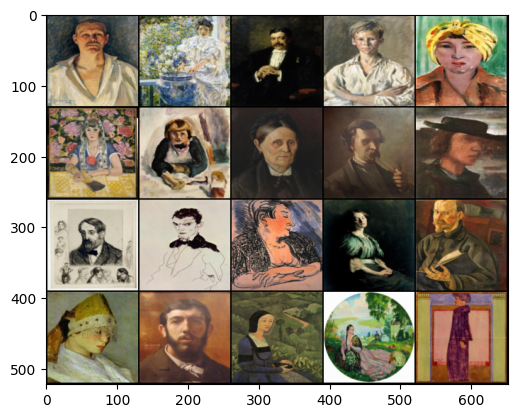

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 55, step 2475: Generator loss: 1.6982618594169632, discriminator loss: 0.4102971926000381


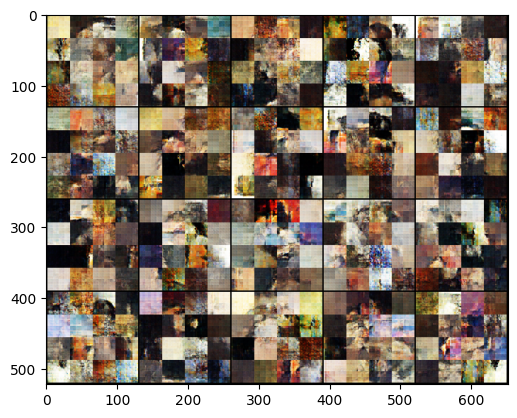

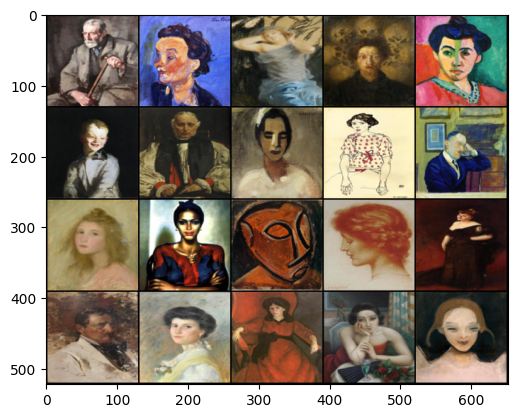

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 60, step 2700: Generator loss: 1.7461362086402052, discriminator loss: 0.3908166768815782


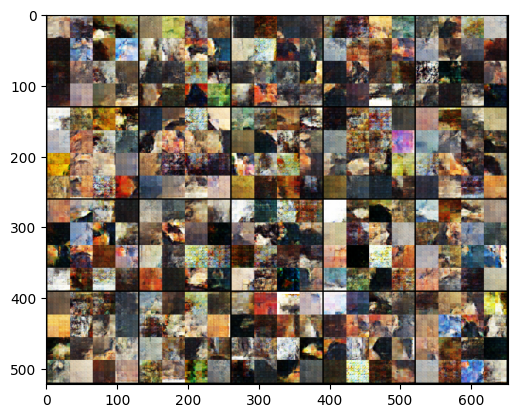

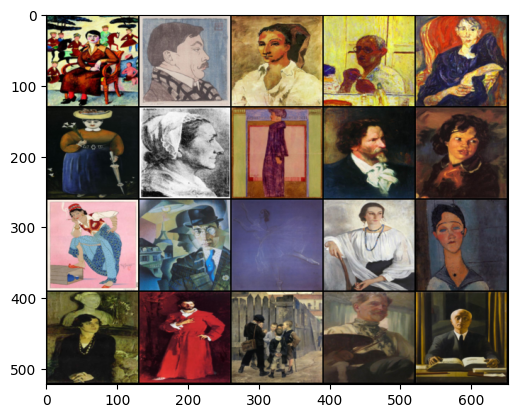

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 65, step 2925: Generator loss: 1.7547486999299788, discriminator loss: 0.39251345660951403


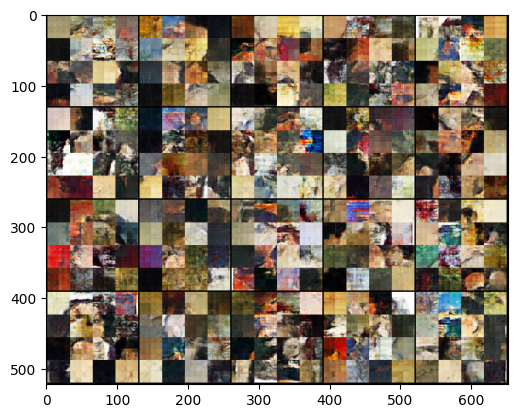

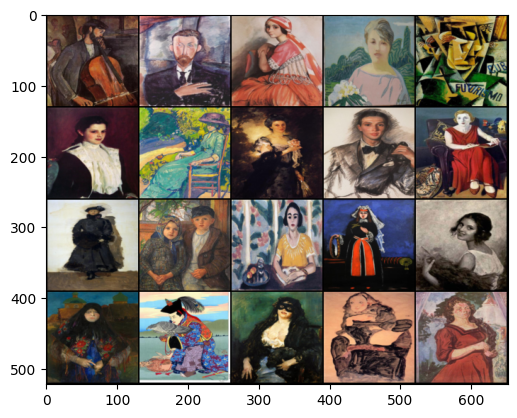

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 70, step 3150: Generator loss: 1.7851880468262566, discriminator loss: 0.3635987177160053


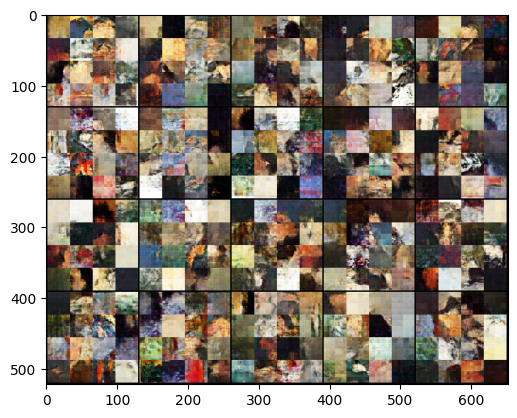

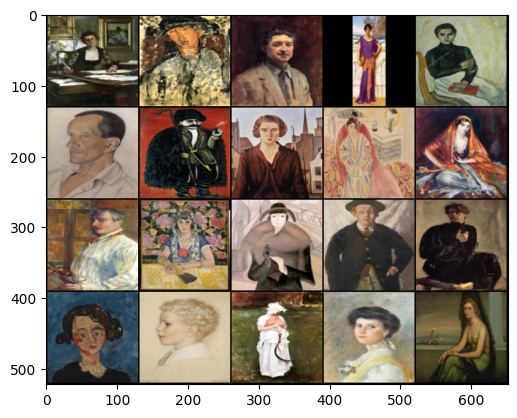

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 75, step 3375: Generator loss: 1.8389487059911087, discriminator loss: 0.3475668141576978


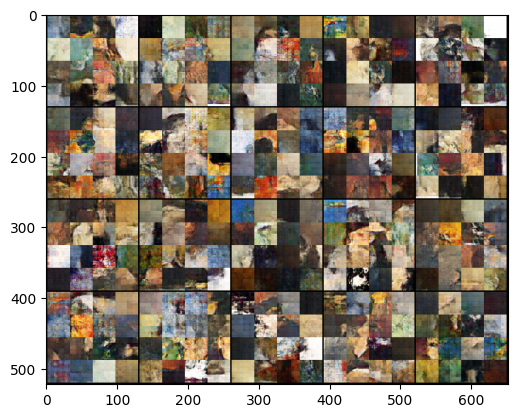

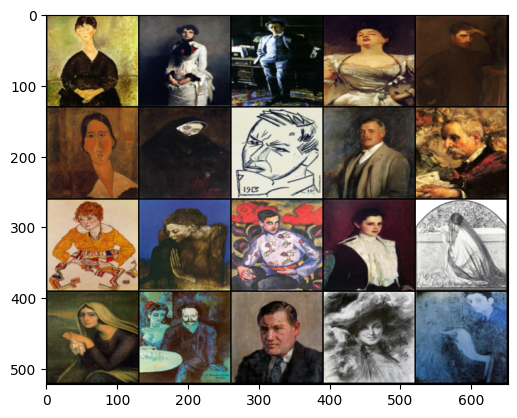

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 80, step 3600: Generator loss: 1.9251763237847217, discriminator loss: 0.3317866732014552


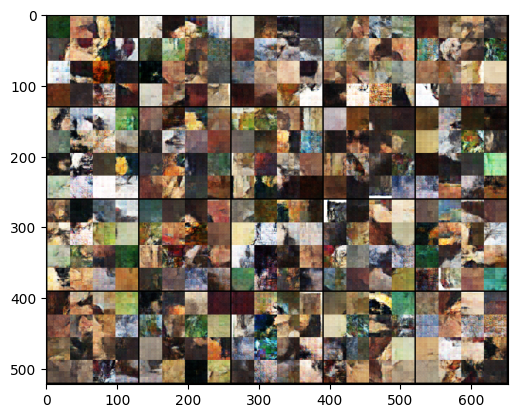

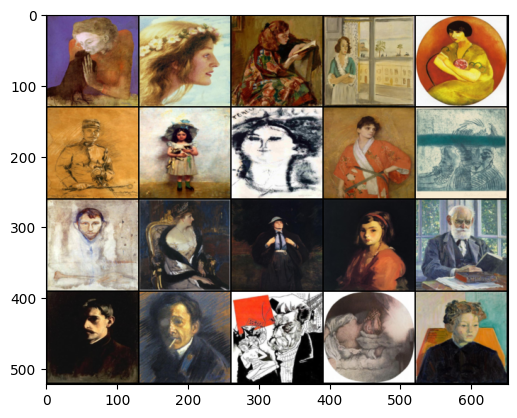

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 85, step 3825: Generator loss: 1.992788488864899, discriminator loss: 0.3063343157370886


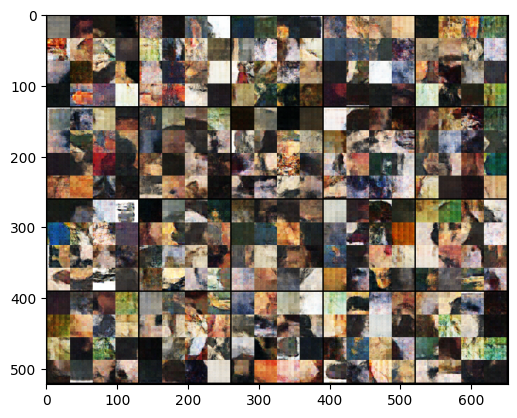

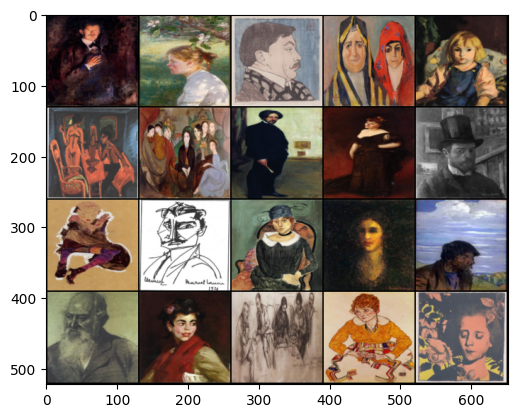

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 90, step 4050: Generator loss: 2.1055567879146992, discriminator loss: 0.28752545369995974


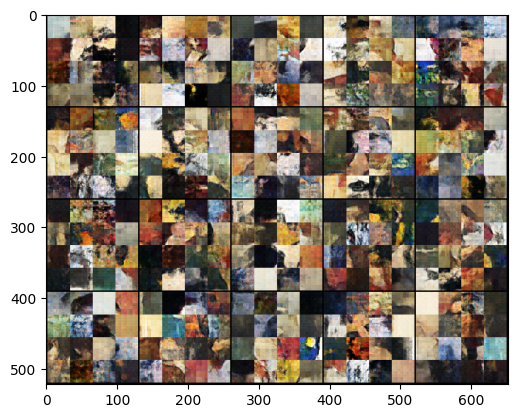

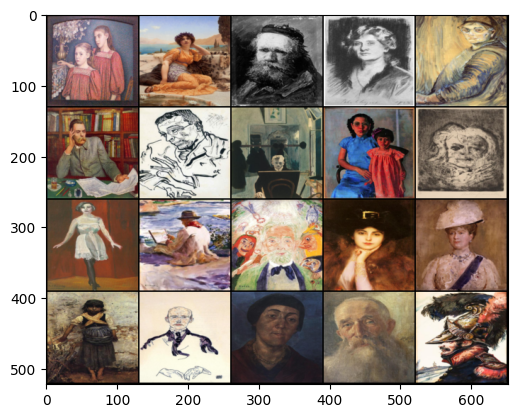

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 95, step 4275: Generator loss: 2.1992343038982822, discriminator loss: 0.2644574667347801


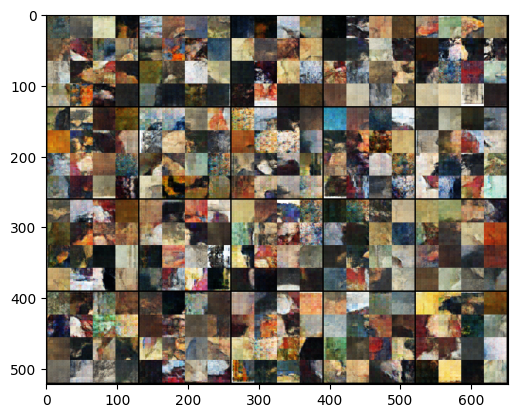

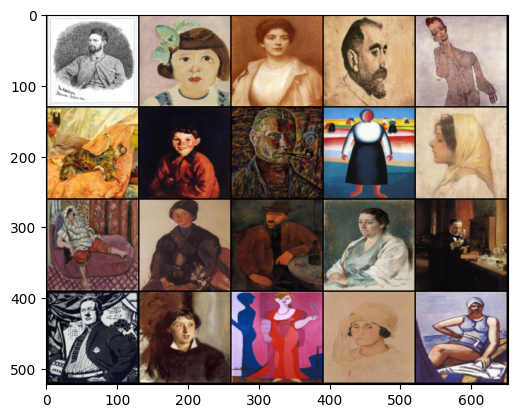

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 100, step 4500: Generator loss: 2.0917731269200637, discriminator loss: 0.3903098683224787


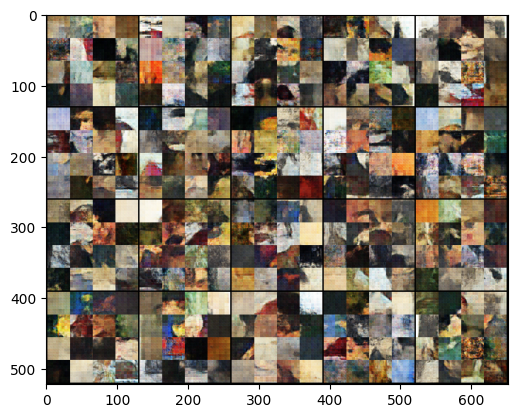

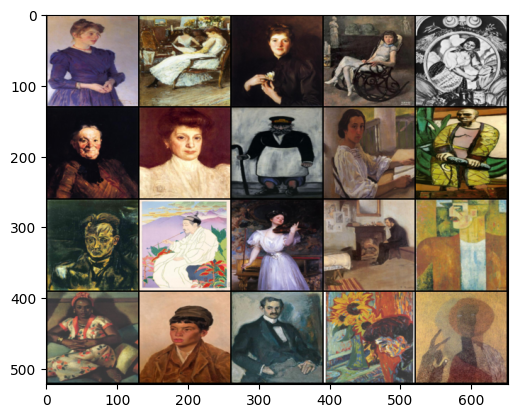

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 105, step 4725: Generator loss: 2.2299517536163327, discriminator loss: 0.2359906405872768


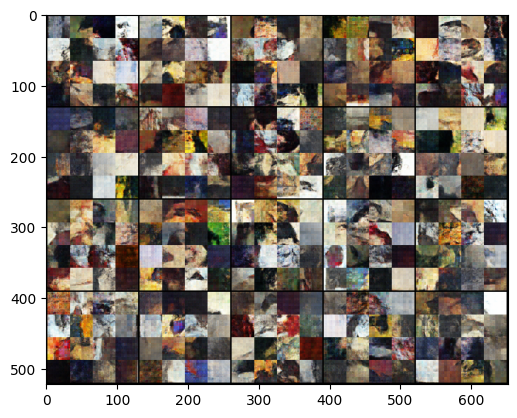

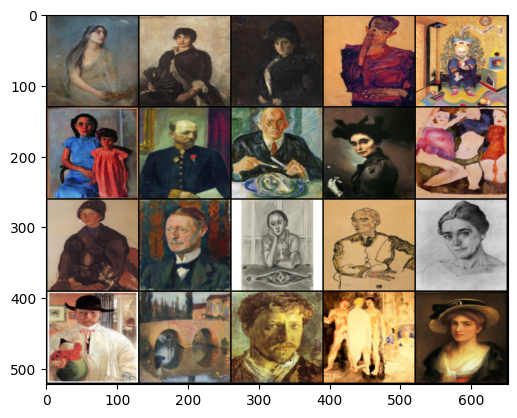

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 110, step 4950: Generator loss: 2.3782509994506835, discriminator loss: 0.21997004674540627


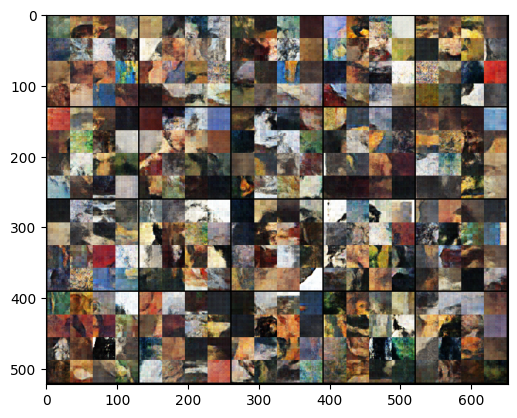

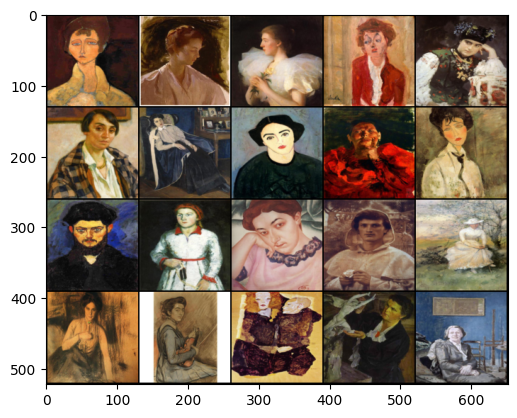

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 115, step 5175: Generator loss: 2.4779367134306165, discriminator loss: 0.22016102910041804


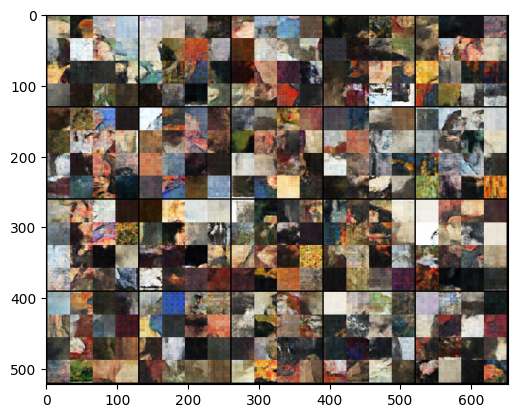

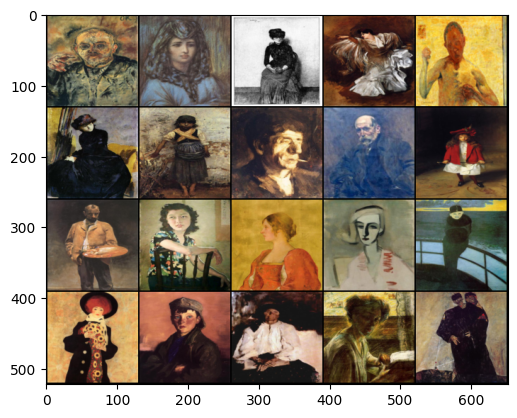

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 120, step 5400: Generator loss: 2.574423784150018, discriminator loss: 0.21298362102773463


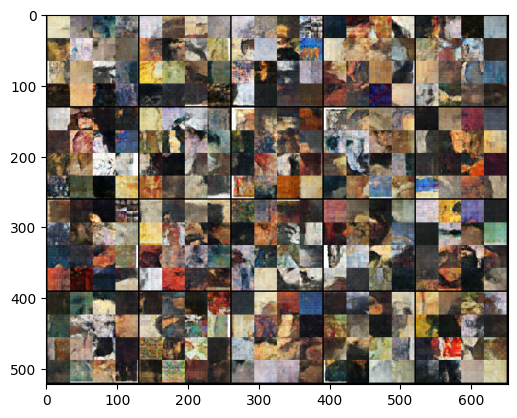

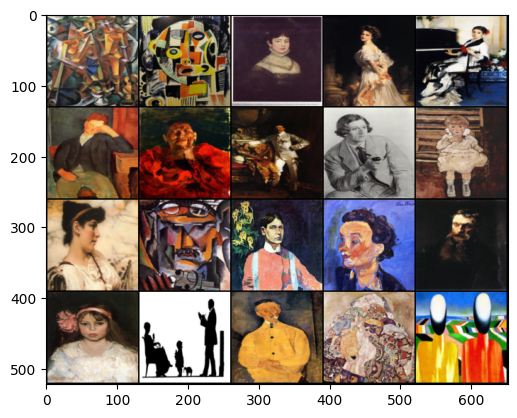

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 125, step 5625: Generator loss: 2.6994779152340356, discriminator loss: 0.17658196747303


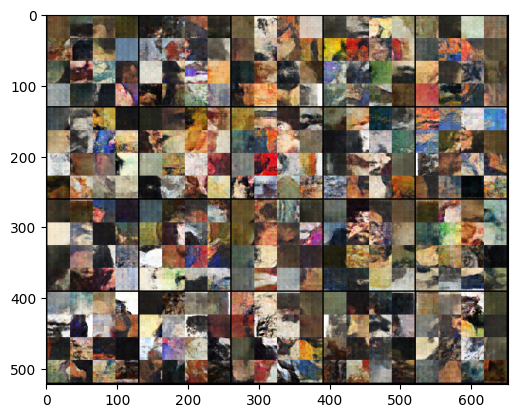

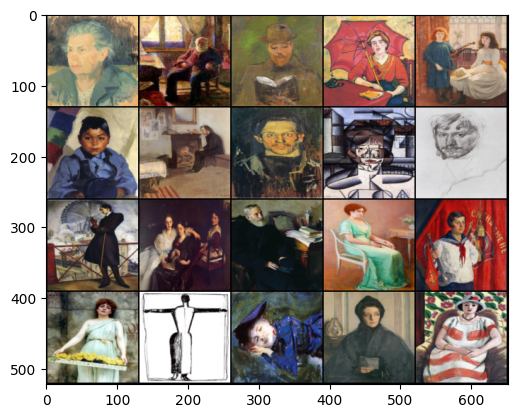

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 130, step 5850: Generator loss: 2.823458373811511, discriminator loss: 0.17489155143499371


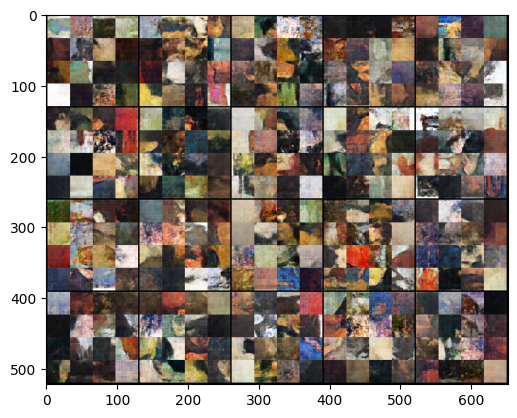

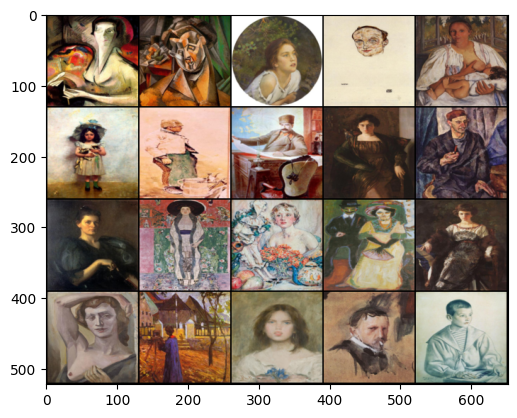

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 135, step 6075: Generator loss: 2.7361676767137326, discriminator loss: 0.36238668246401684


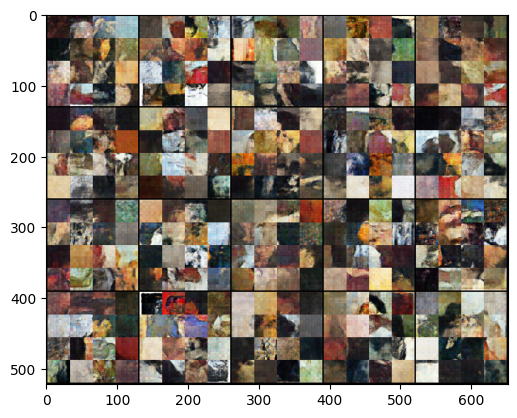

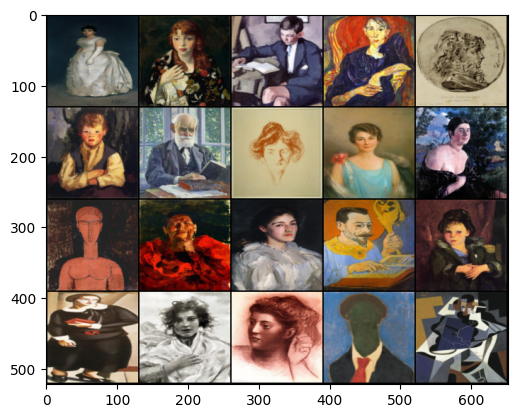

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 140, step 6300: Generator loss: 2.7001669761869644, discriminator loss: 0.16243151356776553


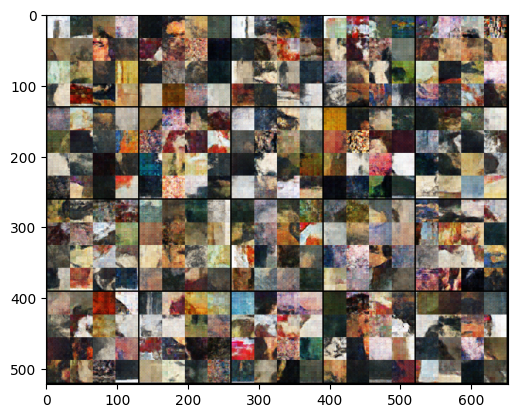

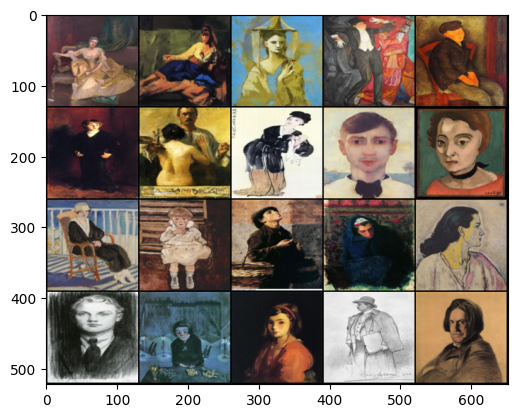

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 145, step 6525: Generator loss: 2.927157768673368, discriminator loss: 0.15350876986980436


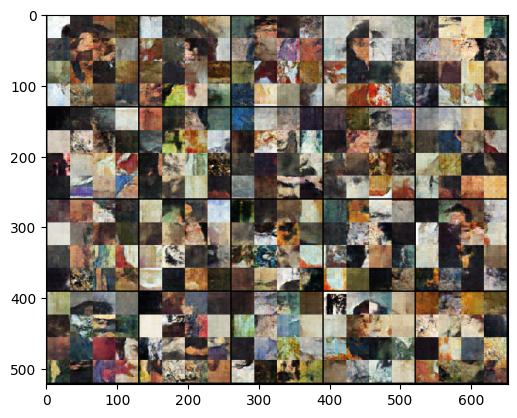

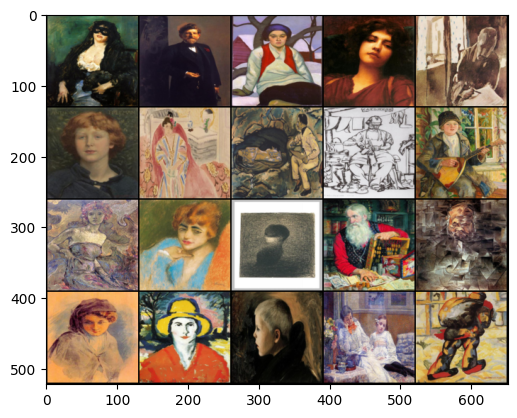

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

In [22]:

n_epochs = 150
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        ## Update discriminator ##
        disc_opt.zero_grad()
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        fake = gen(fake_noise)
        disc_fake_pred = disc(fake.detach())
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_pred = disc(real)
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step
        # Update gradients
        disc_loss.backward(retain_graph=True)
        # Update optimizer
        disc_opt.step()

        ## Update generator ##
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        disc_fake_pred = disc(fake_2)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ## Visualization code ##
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1


  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 5, step 225: Generator loss: 3.0258034610748283, discriminator loss: 0.30598347203599086


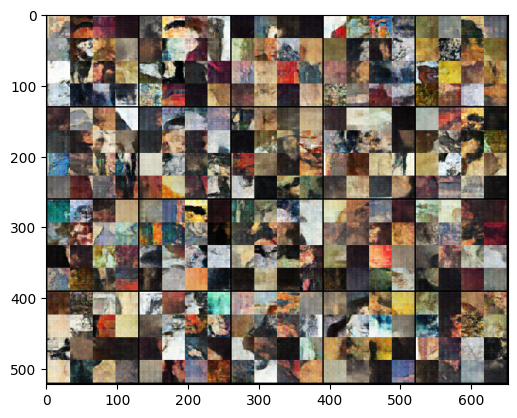

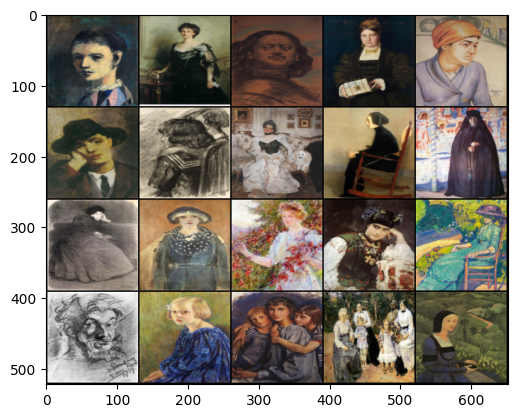

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 10, step 450: Generator loss: 3.004846037758723, discriminator loss: 0.14077826552920866


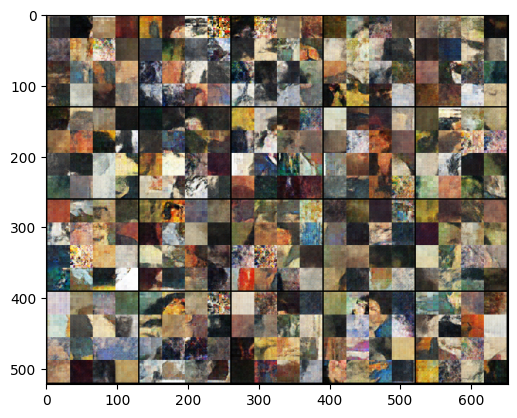

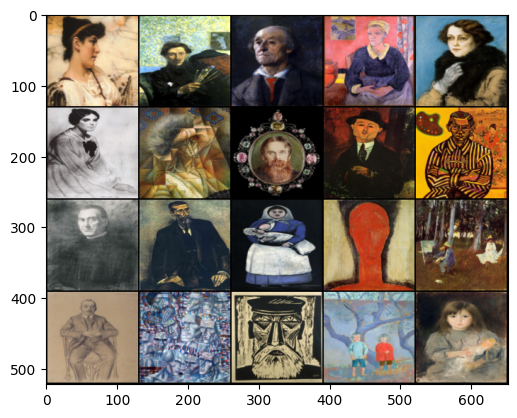

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 15, step 675: Generator loss: 3.2116260814666724, discriminator loss: 0.12215231908692253


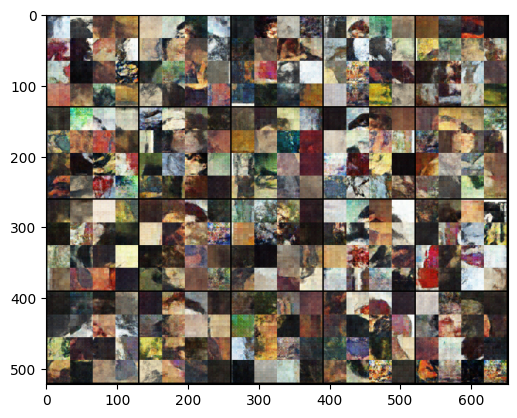

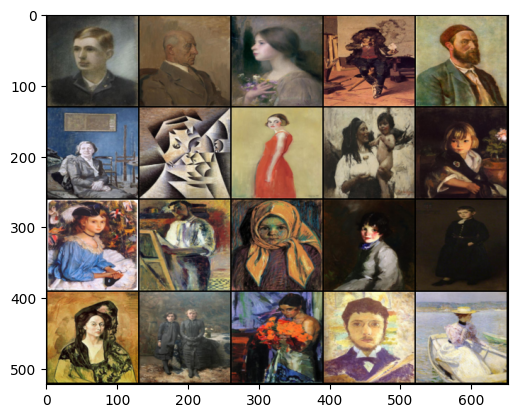

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 20, step 900: Generator loss: 3.3875494702657063, discriminator loss: 0.12266199688116709


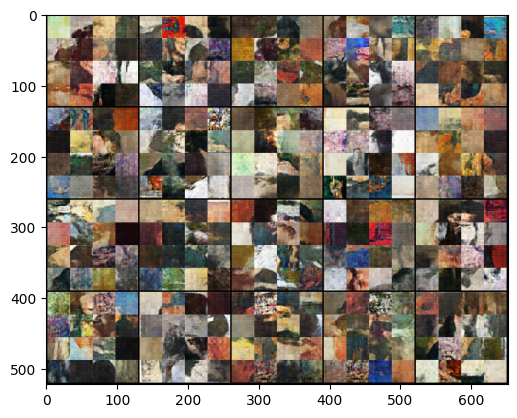

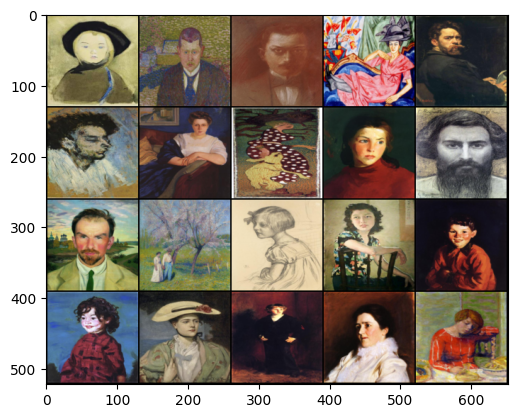

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 25, step 1125: Generator loss: 3.4964054796430797, discriminator loss: 0.11882661246591147


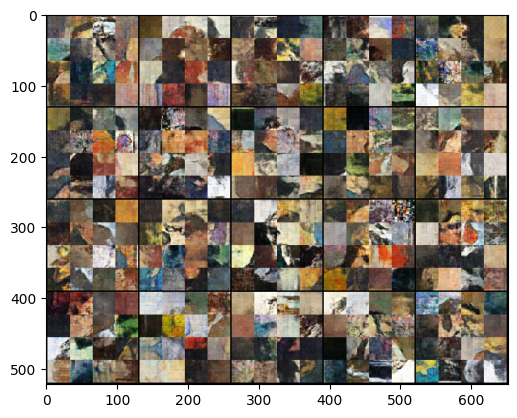

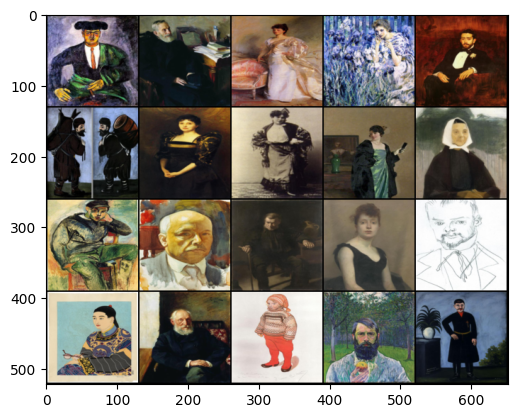

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 30, step 1350: Generator loss: 3.623005373742846, discriminator loss: 0.12269759419891577


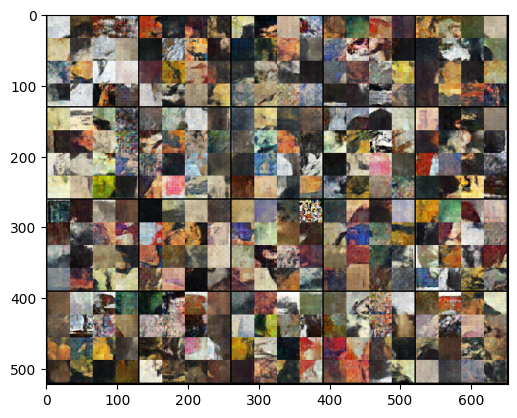

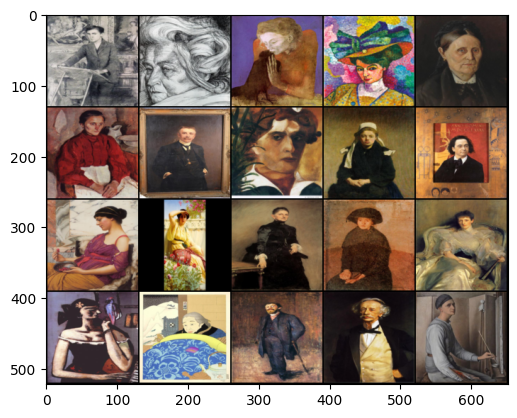

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 35, step 1575: Generator loss: 3.693984359105428, discriminator loss: 0.1084298604726791


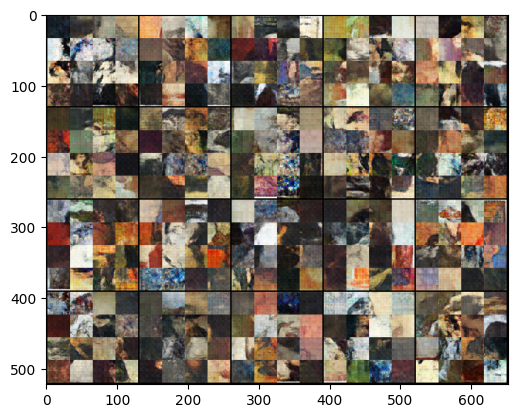

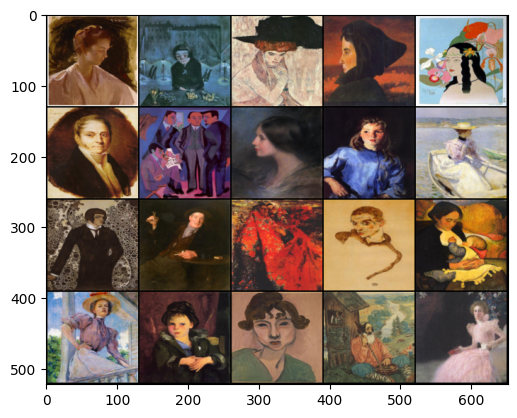

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 40, step 1800: Generator loss: 3.183917919264899, discriminator loss: 0.422372707194752


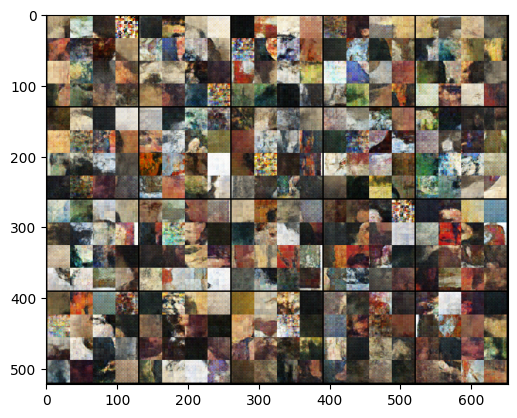

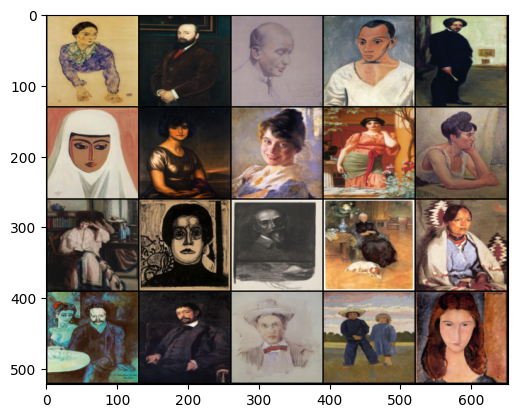

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Epoch 45, step 2025: Generator loss: 3.4158356338077143, discriminator loss: 0.10537929240200258


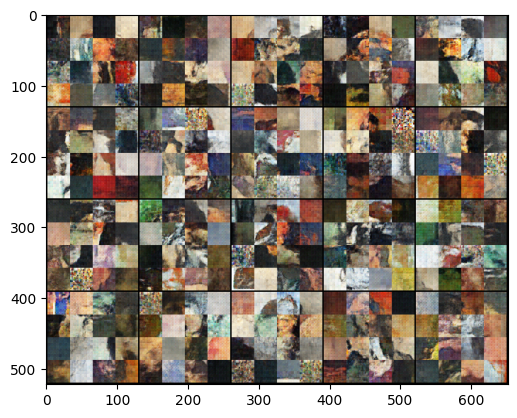

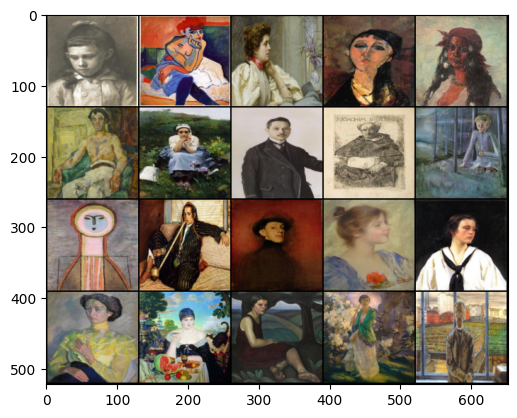

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

In [23]:

n_epochs = 50
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        ## Update discriminator ##
        disc_opt.zero_grad()
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        fake = gen(fake_noise)
        disc_fake_pred = disc(fake.detach())
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_pred = disc(real)
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step
        # Update gradients
        disc_loss.backward(retain_graph=True)
        # Update optimizer
        disc_opt.step()

        ## Update generator ##
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        disc_fake_pred = disc(fake_2)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ## Visualization code ##
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1
